In [1]:
%load_ext autoreload
%autoreload 2
import sys
sys.path.insert(0,'/home/kyle/GWA/NANOGrav/PsrSigSim/')
import psrsigsim as PSS
import numpy as np

#Bokeh imports
from bokeh.io import curdoc, output_file, show, output_notebook
from bokeh.layouts import column, row, widgetbox
from bokeh.models import ColumnDataSource, Range1d, LinearColorMapper
import bokeh.models.widgets as widgets
from bokeh.plotting import figure

output_notebook()

Loading BokehJS ...

In [14]:
#Default values for psr_dict----------------------------------------------------
psr_dict = {}
psr_dict['f0'] = 1400                   #Central frequency
psr_dict['F0'] = 218                    #Pulsar spin freq
psr_dict['bw'] = 400                    #Bandwidth
psr_dict['Nf'] = 250                    #Frequency bins
psr_dict['ObsTime'] = 1000/psr_dict['F0']*70  #Observation time
psr_dict['f_samp'] = 0.05                #Sampling frequency
psr_dict['SignalType'] = "intensity"    #'intensity' which carries a Nf x Nt
#filterbank of pulses or 'voltage' which carries a 4 x Nt array of
#voltage vs. time pulses representing 4 stokes channels
psr_dict['dm'] = 10                   #Dispersion Measure Parsecs/(CM^3)
# V_ISS -- Intersteller Scintilation Velocity
psr_dict['scint_bw'] =  15.6            #Scintilation Bandwidth
psr_dict['scint_timescale'] = 2630      #Scintilation Timescale
# pulsar -- pulsar name
# telescope -- telescope name(GBT or Arecibo)
psr_dict['freq_band'] = 1400            #Frequency band [327 ,430, 820, 1400, 2300]
# aperature -- aperature (m)
# area -- collecting area (m^2)
# Tsys -- system temp (K), total of receiver, sky, spillover, etc. (only needed for noise)
# name -- GBT or Arecibo
# tau_scatter -- scattering time (ms)
psr_dict['radiometer_noise'] =  True   #radiometer noise
psr_dict['data_type']='float32'         #Was int8
psr_dict['flux'] = 3
psr_dict['to_DM_Broaden'] = False
psr_dict['test'] = True

dm_range = (0,10)
dm_range_spacing = 0.25
NumPulses = 1 #Don't change this. A bunch of stuff uses variables that depend on
#this being 1
startingPeriod = 0
start_time = (startingPeriod / psr_dict['F0']) *1000  #Getting start time in ms
TimeBinSize = (1.0/psr_dict['f_samp']) * 0.001
start_bin = int((start_time)/TimeBinSize)
stop_time = (((1 / psr_dict['F0']) *1000) * NumPulses) + start_time
# start_time + however many pulses times the pulsar period in ms
stop_bin =int((stop_time)/TimeBinSize)
first_freq = psr_dict['f0']-(psr_dict['bw']/2)
last_freq = psr_dict['f0']+(psr_dict['bw']/2)


In [15]:
psr = PSS.Simulation(psr =  None , sim_telescope= 'GBT',
                             sim_ism= None, sim_scint= None,
                             sim_dict = psr_dict)

In [16]:
psr.init_signal()
psr.init_pulsar()
psr.init_ism()
psr.pulsar.gauss_template(peak=.5)
psr.init_telescope()

In [17]:
psr.simulate()

96% dispersed in 0.816 seconds.

In [18]:
def show2DPlot(data):
    #To check work
    src2 = ColumnDataSource(data = dict(x = np.linspace(0,1,data.shape[0]), 
                                        y = data ) )
    fig2 = figure(plot_width = 400, plot_height = 400, 
                  #x_range = Range1d(start_time,stop_time), 
                  y_range = Range1d(0,np.max(data)),
                  x_axis_label = 'Pulse Phase',
                  y_axis_label = 'Pulse Intensity',)

    fig2.line(source = src2, x='x', y='y',)
    
    fig2.plot_height = 500
    fig2.plot_width = 500
    
    show(fig2)
    
def show3DPlot(data):
    DMCM = LinearColorMapper(palette="Plasma256")
    
    DMsrc = ColumnDataSource(data=dict(image=[data],x=[start_time],y=[first_freq]))


    DMfig = figure(title='Filter Bank',
                   x_range = Range1d(start_time,stop_time),
                   y_range = Range1d(first_freq,last_freq),
                   x_axis_label = 'Observation Time (ms)',
                   y_axis_label = 'Frequency (MHz)',
                   tools = "crosshair,pan,reset,wheel_zoom")

    DMfig.image(source = DMsrc,image='image',x='x', y='y',# image=[DMFullData[1,:,:]]
                dw=(stop_time-start_time), dh=(last_freq - first_freq),
                color_mapper = DMCM)

    DMfig.plot_height = 500
    DMfig.plot_width = 500

    show(DMfig)

In [19]:
signalFactor = 1.5
curData = psr.signal.signal + psr.obs_signal*signalFactor

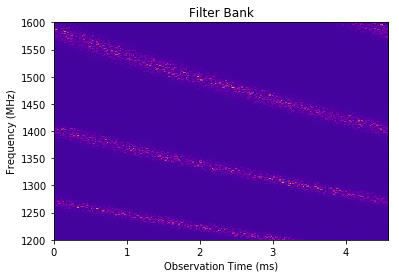

In [20]:
psr.signal.filter_bank(N_pulses=1)

In [21]:
show3DPlot(curData)

In [ ]:
'''
foldfreq = 218
foldper = ((1 / foldfreq) *1000)
binsperperiod = int(foldper / TimeBinSize)
list1 = []
i = binsperperiod
while i < curData.shape[1]:
    list1.append(i)
    i+=binsperperiod
    
foldArr = np.array_split(curData,list1,axis=1)
foldArr = foldArr[0:-1]
for a in foldArr:
    print(a.shape)
foldArr = np.asarray(foldArr)
print(foldArr.shape)
foldArr = np.sum(foldArr,axis=0)
#foldArr = np.swapaxes(foldArr,0,1)
print(foldArr.shape)
'''


In [23]:
def fold(freq):
    foldper = ((1 / freq) *1000)
    binsperperiod = int(foldper / TimeBinSize)
    list1 = []
    i = binsperperiod
    while i < curData.shape[1]:
        list1.append(i)
        i+=binsperperiod
    
    fold1 = np.array_split(curData,list1,axis=1) #Split array into multiple 2D arrays
    fold1 = fold1[0:-1] #Remove the last 2D Array
    fold1 = np.asarray(fold1) 
    fold1 = np.sum(fold1,axis=0)
    return fold1

In [27]:
show3DPlot(fold(218))

In [ ]:
show3DPlot(fold(218*0.95))